In [1]:
from keras.models import Sequential,Model
from keras.layers.core import Dense, Dropout, Activation, Flatten, MaxoutDense
from keras.layers.convolutional import Convolution2D, MaxPooling2D, ZeroPadding2D
from keras.optimizers import SGD, Adadelta, Adagrad
from keras.utils import np_utils, generic_utils
from keras.callbacks import EarlyStopping
from keras.layers.advanced_activations import PReLU, LeakyReLU
from keras.layers import Embedding,GRU,TimeDistributed,RepeatVector,Merge,Input,merge,UpSampling2D

from keras.preprocessing.text import one_hot
from keras.preprocessing import sequence
import numpy as np

from os import listdir
from os.path import isfile, join

import matplotlib.pyplot as plt
import matplotlib.image as mpimg

import PIL
import PIL.Image


import json
from tqdm import tqdm

from keras.optimizers import SGD, RMSprop, Adam

from utils import *
import cPickle as pickle
from matplotlib import pyplot as plt

from itertools import compress

import shutil
import string

import collections

import matplotlib.patches as patches

import os

from keras import callbacks

Using Theano backend.
Using gpu device 0: GeForce GTX 1080 (CNMeM is disabled, cuDNN 5110)
/opt/conda/lib/python2.7/site-packages/theano/sandbox/cuda/__init__.py:600: UserWarning: Your cuDNN version is more recent than the one Theano officially supports. If you see any problems, try updating Theano or downgrading cuDNN to version 5.
  warnings.warn(warn)


In [2]:
def construct_bboxes(image_size, slice_size):
                    
    imageWidth = imageHeight = image_size
    sliceHeight = sliceWidth = slice_size
    
    left = 0 # Set the left-most edge
    upper = 0 # Set the top-most edge

    image_bboxes = []
    mask_bboxes = []
    
    while (left < imageWidth):
        while (upper < imageHeight):
            # If the bottom and right of the cropping box overruns the image.
            if (upper + sliceHeight > imageHeight and \
                left + sliceWidth > imageWidth):
                bbox = (left, upper, imageWidth, imageHeight)
            # If the right of the cropping box overruns the image
            elif (left + sliceWidth > imageWidth):
                bbox = (left, upper, imageWidth, upper + sliceHeight)
            # If the bottom of the cropping box overruns the image
            elif (upper + sliceHeight > imageHeight):
                bbox = (left, upper, left + sliceWidth, imageHeight)
            # If the entire cropping box is inside the image,
            # proceed normally.
            else:
                bbox = (left, upper, left + sliceWidth, upper + sliceHeight)
               
            image_bboxes.append(bbox)
            
            upper += sliceHeight
        left += sliceWidth # Increment the vertical position
        upper = 0

    return image_bboxes

    
    
def load_data(base_path, imgs_suffix, mask_suffix):
    imgs = np.load(base_path + imgs_suffix)
    masks = np.load(base_path + mask_suffix)
    return imgs, masks

def load_train_data(base_path, size):
    return load_data(base_path, 'train_imgs_'+str(size)+'.npy', 'train_masks_'+str(size)+'.npy')

def load_test_data(base_path, size):
    return load_data(base_path, 'test_imgs_'+str(size)+'.npy', 'test_masks_'+str(size)+'.npy')

def load_val_data(base_path, size):
    return load_data(base_path, 'val_imgs_'+str(size)+'.npy', 'val_masks_'+str(size)+'.npy')


def get_images_and_masks(images_path,masks_path, total):
    
    images = os.listdir(images_path)

    if(total!=None):
        images = images[:total]
    else:
        total = len(images)
    
    imgs = []
    imgs_mask = []

    i = 0

    for image_name in tqdm(images):

        img = PIL.Image.open(os.path.join(images_path, image_name))
        img_mask = PIL.Image.open(os.path.join(masks_path, image_name))
        
        imgs.append(img) 
        imgs_mask.append(img_mask)
        

    return (imgs,imgs_mask)
    
    
def create_np_data(images_path,masks_path,resize_dim, total = None):
    
    (imgs,masks) = get_images_and_masks(images_path,masks_path,total)
        
    total = len(imgs)
    
    imgs_np = np.ndarray((total, 3, resize_dim, resize_dim), dtype=np.uint8)
    imgs_mask_np = np.ndarray((total, 1, resize_dim, resize_dim), dtype=np.uint8)

    i = 0

    for index in tqdm(range(len(imgs))):

        img = imgs[index]
        img_mask = masks[index]

        img = img.resize((resize_dim,resize_dim), Image.NEAREST) 
        img_mask = img_mask.resize((resize_dim, resize_dim), Image.NEAREST) 
        
        img = np.array([np.asarray(img)])
        img_mask = np.array([np.asarray(img_mask)])
         
        img = np.transpose(img,(0,3,1,2))
        
        imgs_np[i] = img
        imgs_mask_np[i] = img_mask

        i += 1

    return (imgs_np,imgs_mask_np)


def normalize_imgs(data):
    
    data = data.astype('float32')

    mean = np.mean(data)  # mean for data centering
    std = np.std(data)  # std for data normalization

    data -= mean
    data /= std
    
    return data

def scale_masks(data):
    data = data.astype('float32')
    data /= 255.  # scale masks to [0, 1]
    
    return data
    
    
def get_unet(img_rows, img_cols):
    
    
    inputs = Input((3, img_rows, img_cols))
    conv1 = Convolution2D(32, 3, 3, activation='relu', border_mode='same')(inputs)
    conv1 = Convolution2D(32, 3, 3, activation='relu', border_mode='same')(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)

    conv2 = Convolution2D(64, 3, 3, activation='relu', border_mode='same')(pool1)
    conv2 = Convolution2D(64, 3, 3, activation='relu', border_mode='same')(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)

    conv3 = Convolution2D(128, 3, 3, activation='relu', border_mode='same')(pool2)
    conv3 = Convolution2D(128, 3, 3, activation='relu', border_mode='same')(conv3)
    pool3 = MaxPooling2D(pool_size=(2, 2))(conv3)

    conv4 = Convolution2D(256, 3, 3, activation='relu', border_mode='same')(pool3)
    conv4 = Convolution2D(256, 3, 3, activation='relu', border_mode='same')(conv4)
    pool4 = MaxPooling2D(pool_size=(2, 2))(conv4)

    conv5 = Convolution2D(512, 3, 3, activation='relu', border_mode='same')(pool4)
    conv5 = Convolution2D(512, 3, 3, activation='relu', border_mode='same')(conv5)

    up6 = merge([UpSampling2D(size=(2, 2))(conv5), conv4], mode='concat', concat_axis=1)
    conv6 = Convolution2D(256, 3, 3, activation='relu', border_mode='same')(up6)
    conv6 = Convolution2D(256, 3, 3, activation='relu', border_mode='same')(conv6)

    up7 = merge([UpSampling2D(size=(2, 2))(conv6), conv3], mode='concat', concat_axis=1)
    conv7 = Convolution2D(128, 3, 3, activation='relu', border_mode='same')(up7)
    conv7 = Convolution2D(128, 3, 3, activation='relu', border_mode='same')(conv7)

    up8 = merge([UpSampling2D(size=(2, 2))(conv7), conv2], mode='concat', concat_axis=1)
    conv8 = Convolution2D(64, 3, 3, activation='relu', border_mode='same')(up8)
    conv8 = Convolution2D(64, 3, 3, activation='relu', border_mode='same')(conv8)

    up9 = merge([UpSampling2D(size=(2, 2))(conv8), conv1], mode='concat', concat_axis=1)
    conv9 = Convolution2D(32, 3, 3, activation='relu', border_mode='same')(up9)
    conv9 = Convolution2D(32, 3, 3, activation='relu', border_mode='same')(conv9)

    conv10 = Convolution2D(1, 1, 1, activation='sigmoid')(conv9)

    model = Model(input=inputs, output=conv10)

#     model.compile(optimizer=Adam(lr=1e-5), loss=dice_coef_loss, metrics=[dice_coef])
    model.compile(optimizer=Adam(lr=0.001),loss='categorical_crossentropy', metrics=['accuracy'])
    return model


def draw_bboxes(img,image_bboxes):

    # Create figure and axes
    fig,ax = plt.subplots(1)

    # Display the image
    ax.imshow(img)

    # Create a Rectangle patch
    
    for image_bbox in image_bboxes:
        x1 = image_bbox[0]
        y1 = image_bbox[1]
        x2 = image_bbox[2]
        y2 = image_bbox[3]    
        rect = patches.Rectangle((x1,y1),x2-x1,y2-y1,linewidth=1,edgecolor='r',facecolor='none')
        ax.add_patch(rect)

    plt.show()
    
def process_data(images_path,masks_path,bboxes,initial_pic_dim,bbox_size, total = 10):
    
    (imgs,masks) = get_images_and_masks(images_path,masks_path, total)
        
    total = len(imgs) * len (bboxes)
    
    imgs_np = np.ndarray((total, 3, bbox_size, bbox_size), dtype=np.uint8)
    imgs_mask_np = np.ndarray((total, 1, bbox_size, bbox_size), dtype=np.uint8)

    i = 0

    for index in tqdm(range(len(imgs))):

        raw_img = imgs[index]
        raw_mask = masks[index]
            
        for bbox in bboxes:
            
            img = raw_img.resize((initial_pic_dim,initial_pic_dim), PIL.Image.NEAREST)
            img_mask = raw_mask.resize((initial_pic_dim,initial_pic_dim), PIL.Image.NEAREST)
            
            img = img.crop(bbox)
            img_mask = img_mask.crop(bbox)
            
            img = np.array([np.asarray(img)])
            img_mask = np.array([np.asarray(img_mask)])

            img = np.transpose(img,(0,3,1,2))

            imgs_np[i] = img
            imgs_mask_np[i] = img_mask

            i += 1

    return imgs_np,np.transpose(np.stack(imgs),(0,3,1,2)),imgs_mask_np,np.stack(masks)

def merge_slices(image_slices,number_bboxes,step=6):
    cols = []
    for i in range(0,number_bboxes,step):
        current_col = image_slices[i:i+step,:,:,:]
        current_col = np.concatenate(current_col,axis=1)
        current_col = np.transpose(current_col,(1,2,0))
        cols.append(current_col)
    return np.concatenate(cols,axis=1)

def plot_slices_merged(plot_images,plot_masks,predictions,nr_slices_in_pic = 36):
    
    total_no_images = len(plot_images)
    
    nr_cols = 3
    figsize = 15
    
    pic_index = 1
    for i in range(0,total_no_images,nr_slices_in_pic):
        image_slices = plot_images[i:i+nr_slices_in_pic,:,:,:]
        mask_slices = plot_masks[i:i+nr_slices_in_pic,:,:,:]
        prediction_slices = predictions[i:i+nr_slices_in_pic,:,:,:]
        
        merged_images = merge_slices(image_slices,nr_slices_in_pic)
        merged_masks = merge_slices(mask_slices,nr_slices_in_pic)
        merged_predictions = merge_slices(prediction_slices,nr_slices_in_pic)

        plt.figure(figsize=(figsize,figsize))
        
        plt.subplot(1,nr_cols,1)
        plt.imshow(merged_images)
        
        plt.subplot(1,nr_cols,2)
        plt.imshow(np.squeeze(merged_masks))

        plt.subplot(1,nr_cols,3)
        plt.imshow(np.squeeze(merged_predictions))

        
        plt.figure(figsize=(figsize,figsize))
        
        
    plt.show()
    
def plot_data(imgs,masks,nr_imgs):

    for index in range(nr_imgs):
        plt.figure(figsize=(15,15))

        plt.subplot(1,3,1)
        plt.imshow(np.transpose(imgs[index],(1,2,0)))

        plt.subplot(1,3,2)
        plt.imshow(np.squeeze(masks[index]), cmap='cool')

        plt.subplot(1,3,3)
        plt.imshow(np.transpose(imgs[index],(1,2,0)))
        plt.imshow(np.squeeze(masks[index]), cmap='cool',alpha=0.5)

        plt.figure()

    plt.show()

def plot_predicted_vs_ground_truth(predictions, images, masks, min_index, max_index):
    
    nr_rows = max_index - min_index
    nr_cols = 2
    pic_index = 1
    
    plt.figure(figsize=(15,15))
    for index in range(min_index,max_index):
   
        raw_pred = predictions[index]
        squeezed_pred = np.squeeze(raw_pred)
#         squeezed_pred = threshold(squeezed_pred)

        raw_mask = masks[index]
        raw_mask = np.squeeze(raw_mask)
        
        image = images[index]
        image = np.transpose(image,(1,2,0))
        
        nr_cols = 3
        plt.subplot(1,nr_cols,1)
        pic_index+=1
        plt.imshow(squeezed_pred, cmap='Greys',  interpolation='nearest')
        
        plt.subplot(1,nr_cols,2)
        plt.imshow(raw_mask)
        pic_index+=1
        
        plt.subplot(1,nr_cols,3)
        plt.imshow(image)
        pic_index+=1
        
        plt.figure(figsize=(15,15))
        
    plt.show()
    
def plot_normalized_data(proc_train_imgs,proc_train_masks,nr_imgs):
    
    for index in range(nr_imgs):
        
        plt.subplot(121)
        plt.imshow(np.transpose(proc_train_imgs[index],(1,2,0)))
        plt.subplot(122)
        plt.imshow(np.squeeze(proc_train_masks[index]), cmap='Greys',  interpolation='nearest')
        
        plt.figure()
    
    plt.show()

# Setup some paths

In [3]:
base_path = "../../../datasets/road-segmentation/"

train_images_path = base_path + "european-roads/train/sat/"
train_masks_path = base_path + "european-roads/train/map/"

val_images_path = base_path +"european-roads/valid/sat"
val_masks_path = base_path +"european-roads/valid/map"

test_images_path = base_path +"european-roads/test/sat"
test_masks_path = base_path +"european-roads/test/map"


np_save_path = "../../nps/"
slices_np_save_path = "../../slices_nps/"

models_path = "../models/"

# Image sizes

In [4]:
img_dim  = 1344
slice_dim = 224

bboxes = construct_bboxes(img_dim,slice_dim)

# Read data

In [5]:
(train_imgs, train_full_imgs, train_masks, train_full_masks) = \
                process_data(train_images_path, train_masks_path, bboxes,img_dim, slice_dim, 10)
    
(val_imgs, val_full_imgs, val_masks, val_full_masks) = \
                process_data(val_images_path, val_masks_path, bboxes,img_dim, slice_dim , 10)
    
(test_imgs, test_full_imgs, test_masks, test_full_masks) = \
                process_data(test_images_path, test_masks_path, bboxes,img_dim, slice_dim, 10)


100%|██████████| 10/10 [00:02<00:00,  3.79it/s]


In [6]:
print("TRAIN")
print(train_full_imgs.shape)
print(train_full_masks.shape)

print("\n\nVALIDATION")
print(val_full_imgs.shape)
print(val_full_masks.shape)


print("\n\nTEST")
print(test_full_imgs.shape)
print(test_full_masks.shape)

TRAIN
(10, 3, 1600, 1550)
(10, 1600, 1550)


VALIDATION
(10, 3, 1600, 1550)
(10, 1600, 1550)


TEST
(10, 3, 1600, 1550)
(10, 1600, 1550)


# Merge train & validation sets

In [7]:
train_imgs = np.vstack([train_imgs,val_imgs])
train_masks = np.vstack([train_masks,val_masks])

# Visualize Full Images

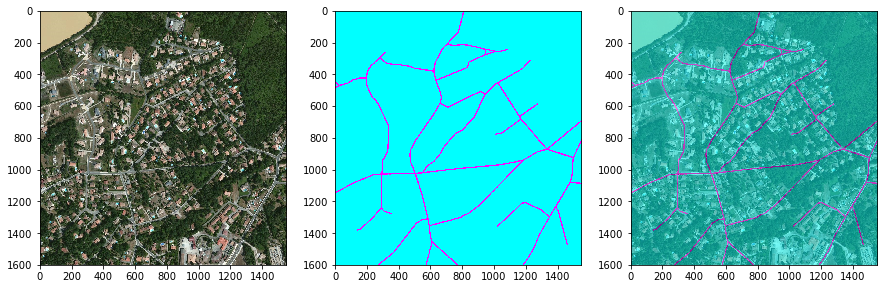

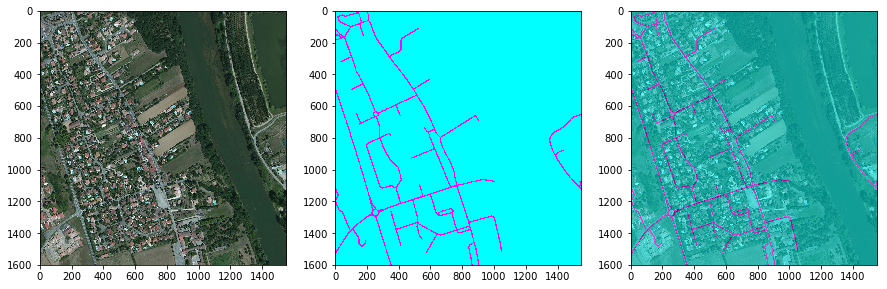

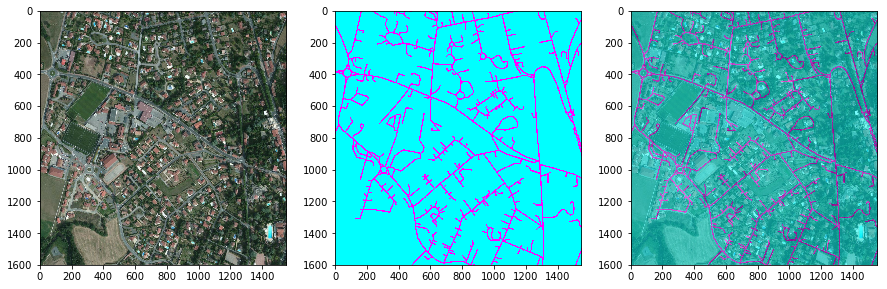

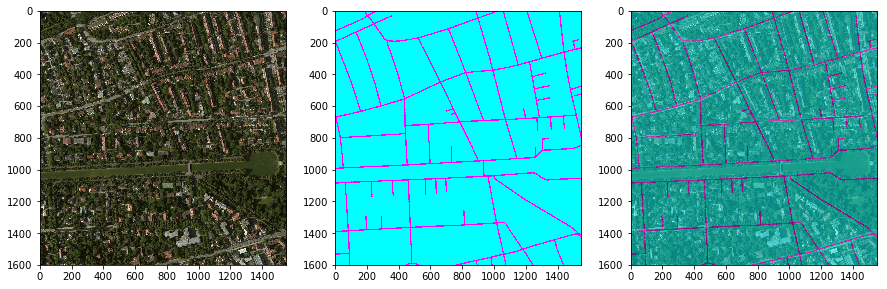

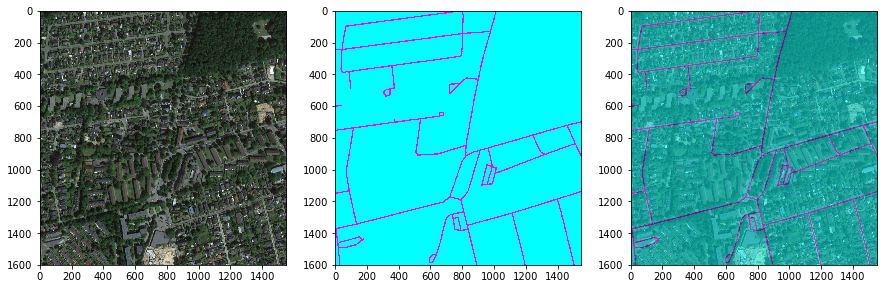

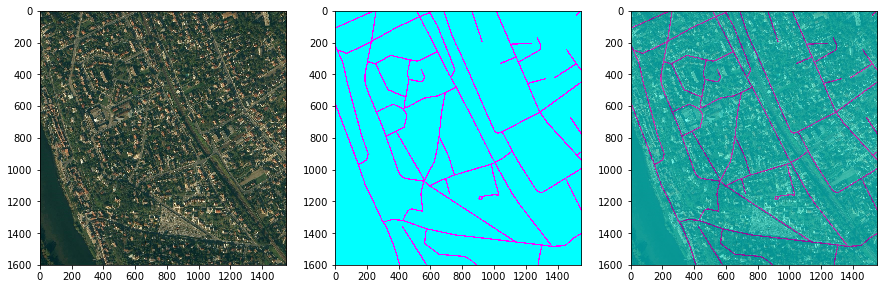

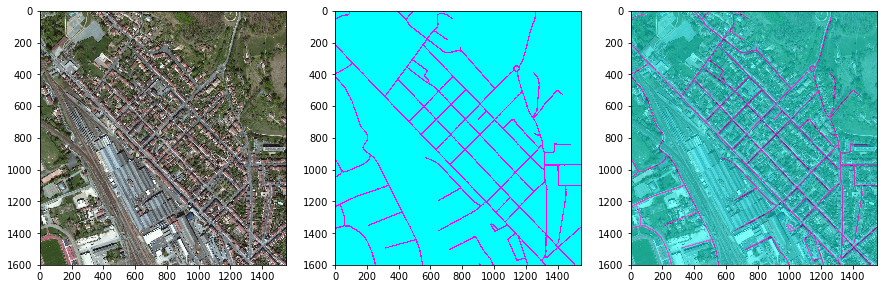

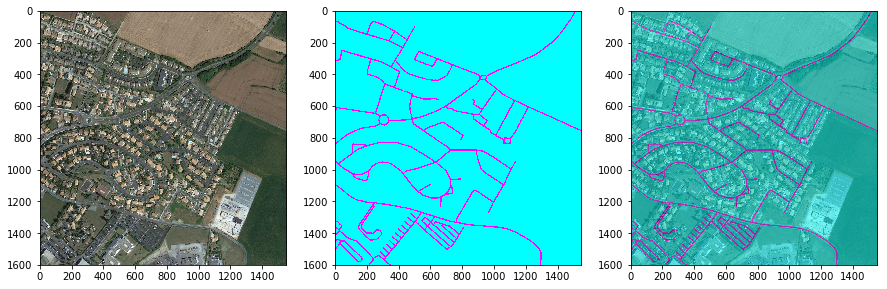

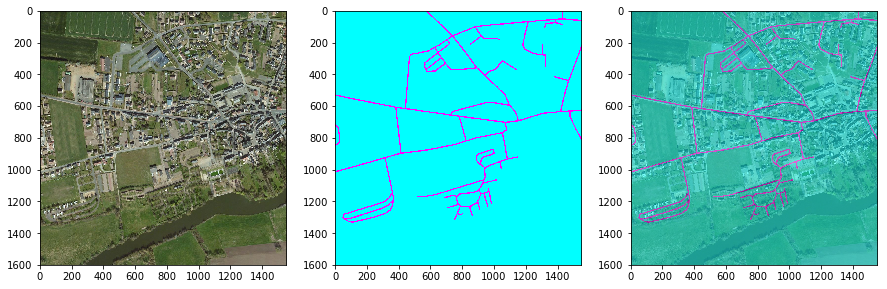

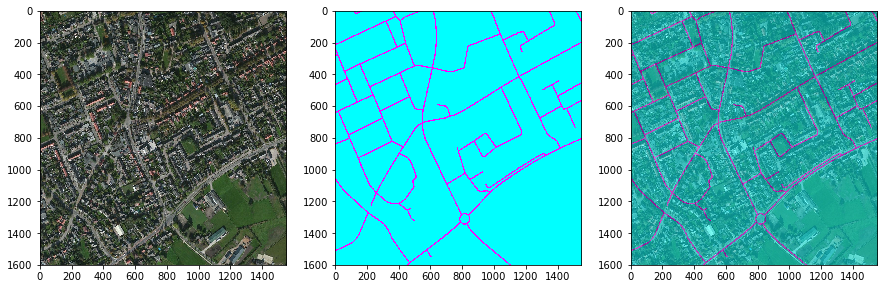

In [8]:
plot_data(train_full_imgs,train_full_masks,10)

# Visualize Split Images

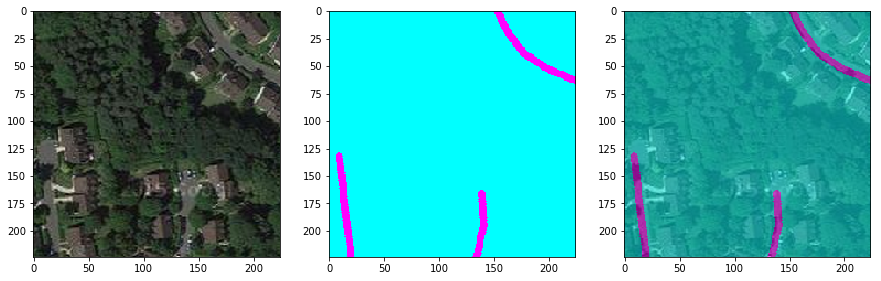

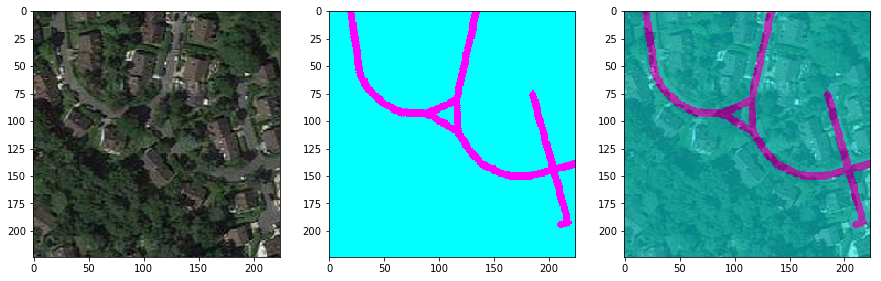

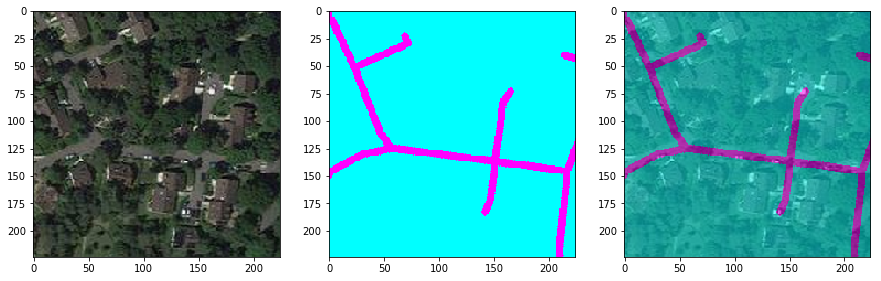

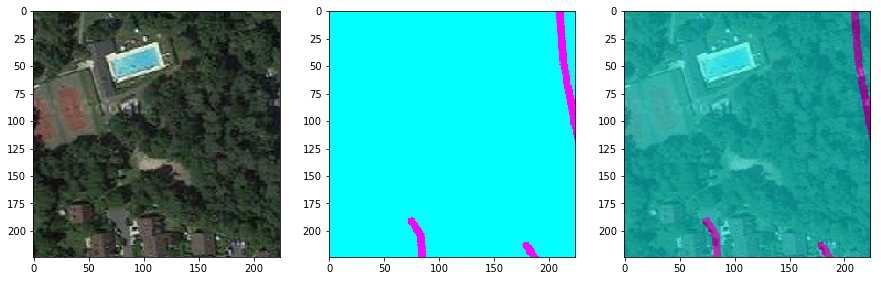

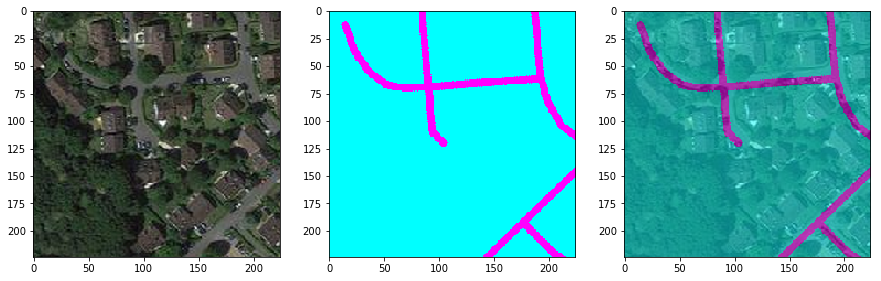

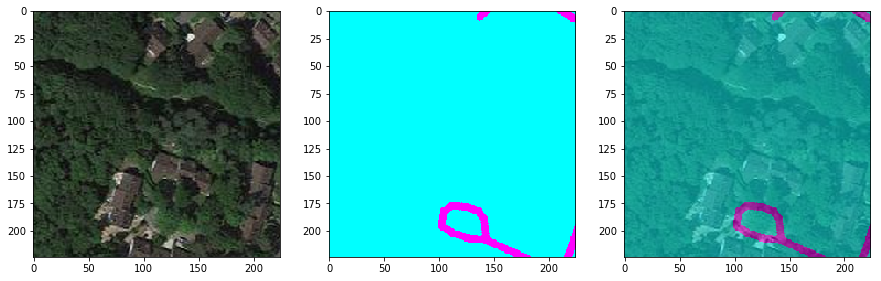

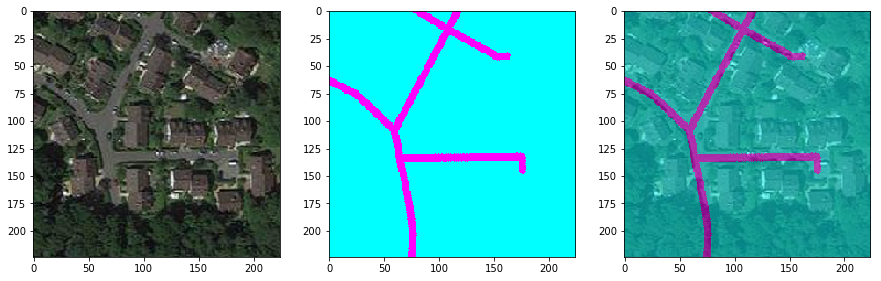

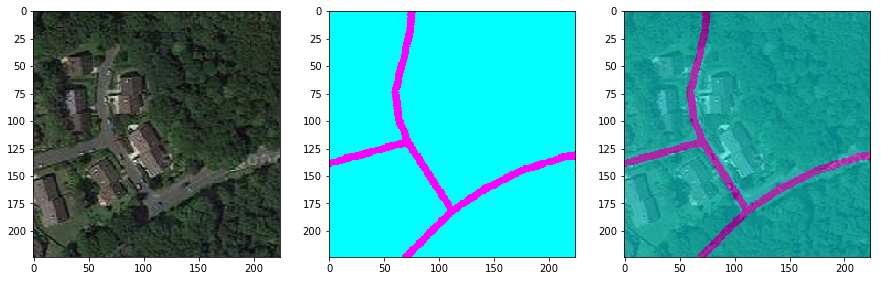

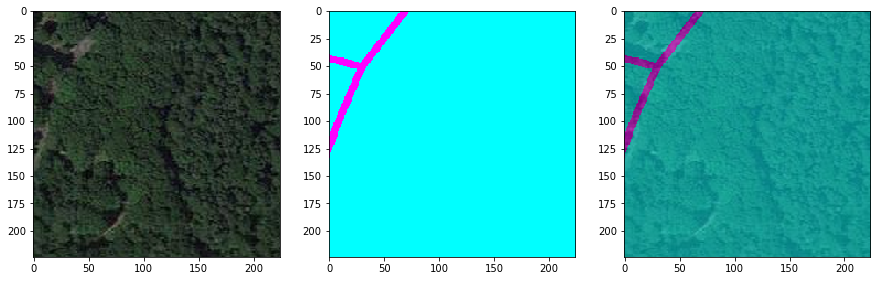

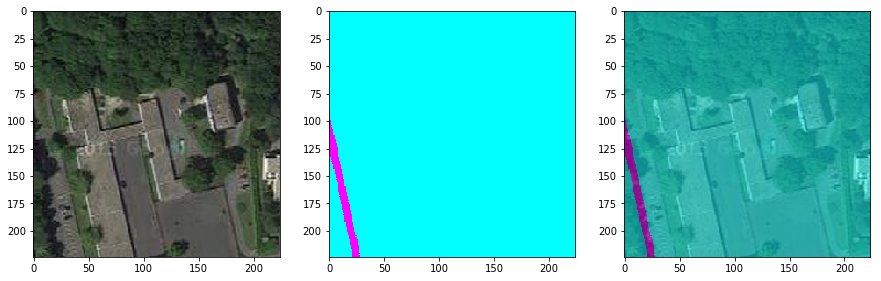

In [9]:
plot_data(test_imgs,test_masks,10)

In [10]:
print("TRAIN")
print(train_imgs.shape)
print(train_masks.shape)

print("\n\nTEST")
print(test_imgs.shape)
print(test_masks.shape)

TRAIN
(720, 3, 224, 224)
(720, 1, 224, 224)


TEST
(360, 3, 224, 224)
(360, 1, 224, 224)


# TODO ADD AUGMENTATION

## Training 

In [11]:
proc_train_imgs = normalize_imgs(train_imgs)
proc_train_masks = scale_masks(train_masks)

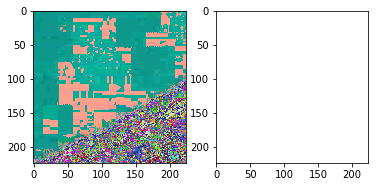

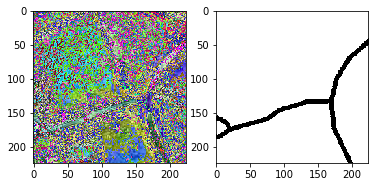

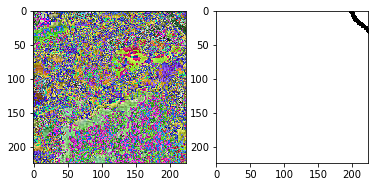

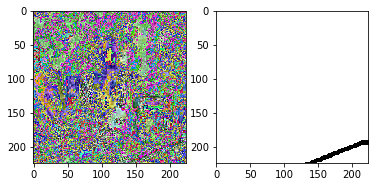

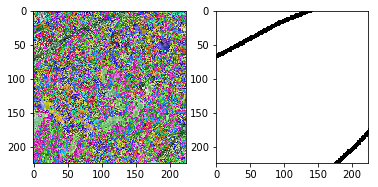

In [12]:
plot_normalized_data(proc_train_imgs,proc_train_masks,5)

# Create Model

In [13]:
model = get_unet(slice_dim,slice_dim)
model.summary()

____________________________________________________________________________________________________
Layer (type)                     Output Shape          Param #     Connected to                     
input_1 (InputLayer)             (None, 3, 224, 224)   0                                            
____________________________________________________________________________________________________
convolution2d_1 (Convolution2D)  (None, 32, 224, 224)  896         input_1[0][0]                    
____________________________________________________________________________________________________
convolution2d_2 (Convolution2D)  (None, 32, 224, 224)  9248        convolution2d_1[0][0]            
____________________________________________________________________________________________________
maxpooling2d_1 (MaxPooling2D)    (None, 32, 112, 112)  0           convolution2d_2[0][0]            
___________________________________________________________________________________________

# Train the model

In [ ]:
model.fit(proc_train_imgs, 
          proc_train_masks, 
          batch_size=32, 
          nb_epoch=5,
          verbose=1,
          callbacks=[callbacks.RemoteMonitor()]
         )

In [ ]:
# model.save_weights(models_path+"slices_3_epochs.h5")

In [14]:
model.load_weights(models_path+"slices_2_epochs.h5")

# Test the model

In [15]:
test_imgs, test_masks = load_test_data(slices_np_save_path, slice_dim)

print(test_imgs.shape)
print(test_masks.shape)

(1800, 3, 224, 224)
(1800, 1, 224, 224)


In [16]:
proc_test_imgs = normalize_imgs(test_imgs)
proc_test_masks = scale_masks(test_masks)

In [17]:
NR_PREDICTIONS = 720

data_to_predict = proc_train_imgs[:NR_PREDICTIONS]
plot_images = train_imgs[:NR_PREDICTIONS]
plot_masks = train_masks[:NR_PREDICTIONS]


In [18]:
predictions = model.predict(data_to_predict, verbose = 1)
predictions.shape

720/720 [==============================] - 8s     

(720, 1, 224, 224)

/opt/conda/lib/python2.7/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


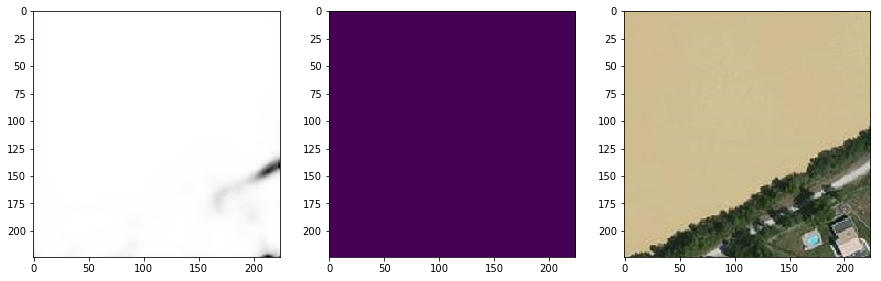

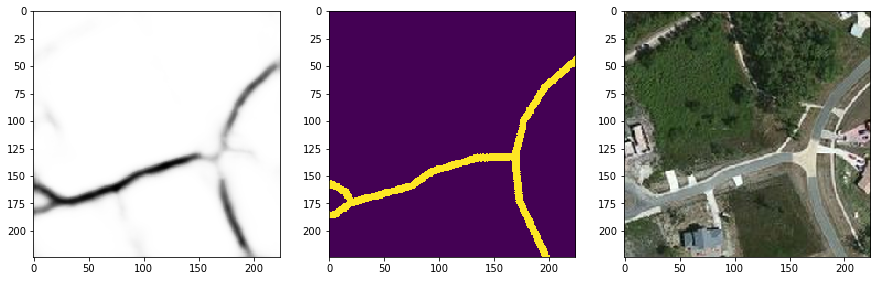

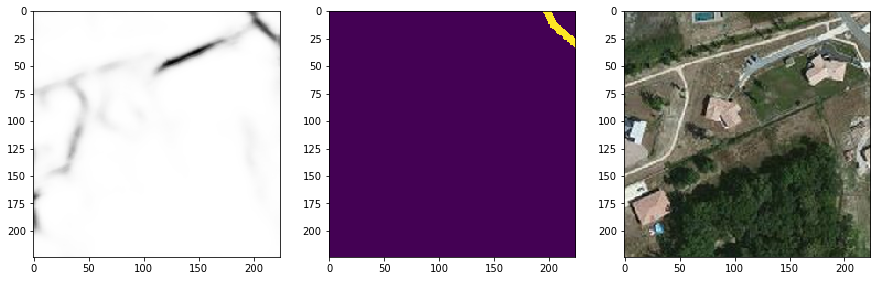

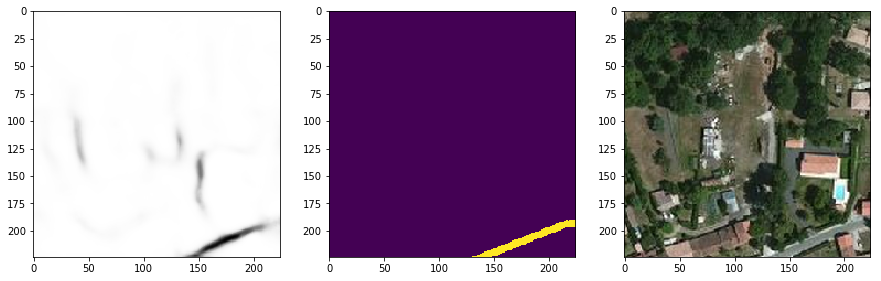

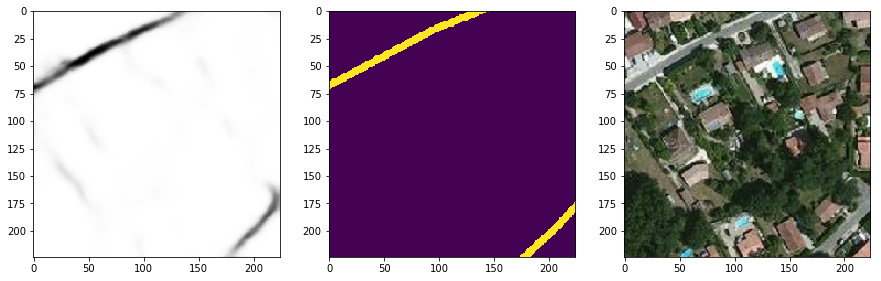

...

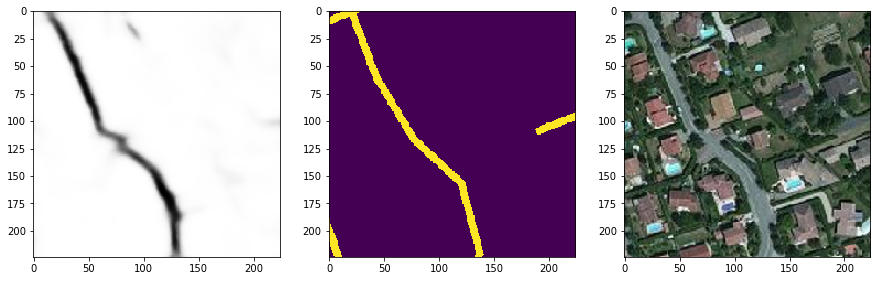

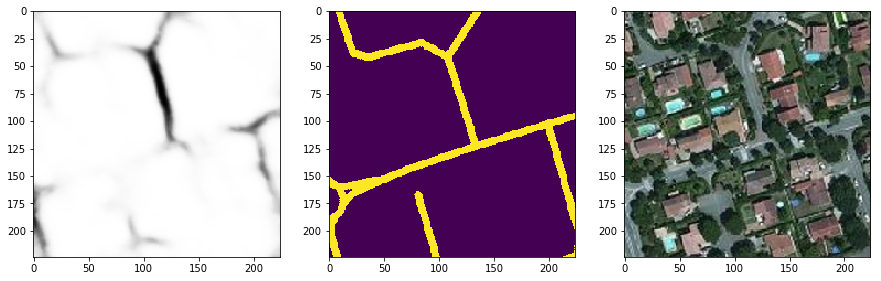

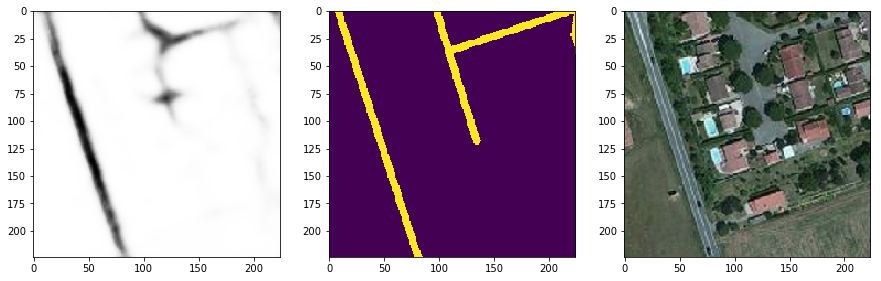

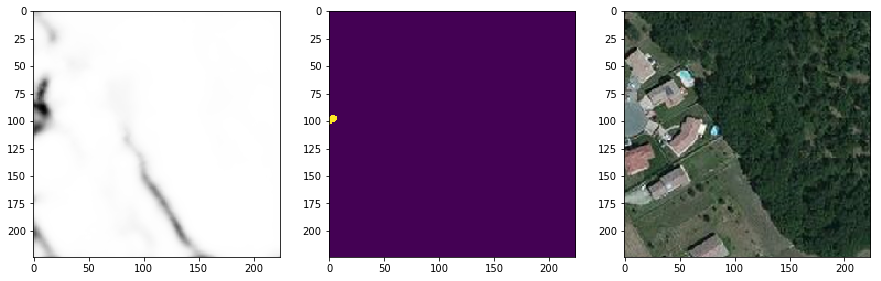

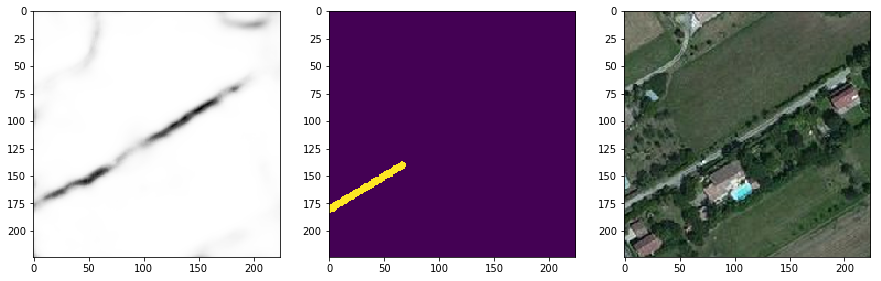

In [19]:
plot_predicted_vs_ground_truth(predictions, plot_images,plot_masks, 0,50)

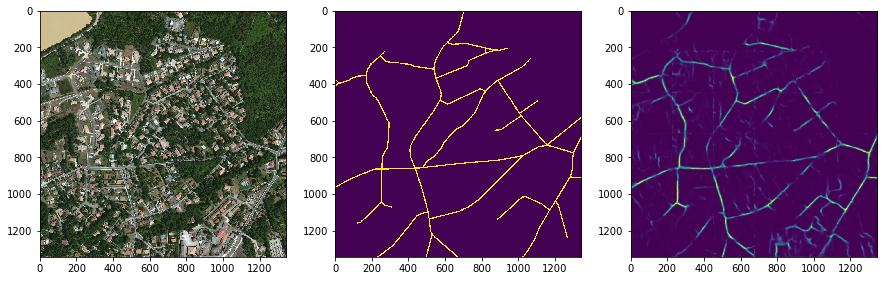

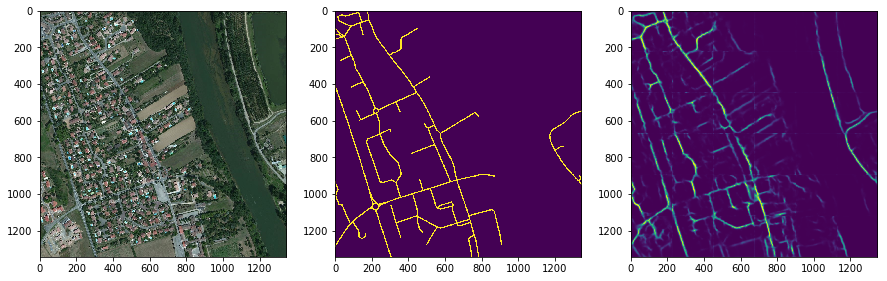

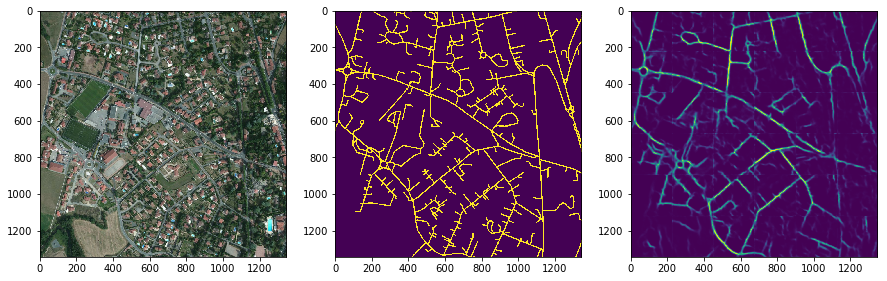

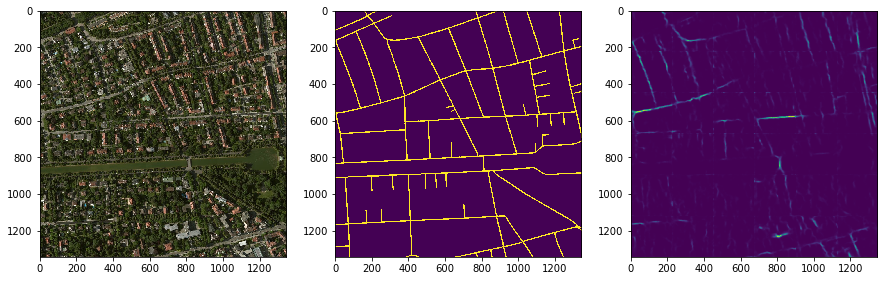

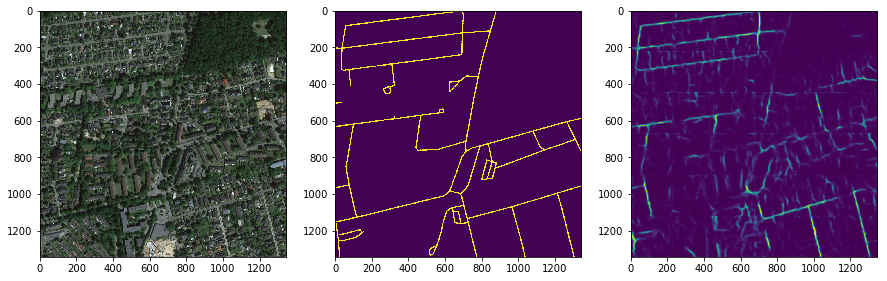

...

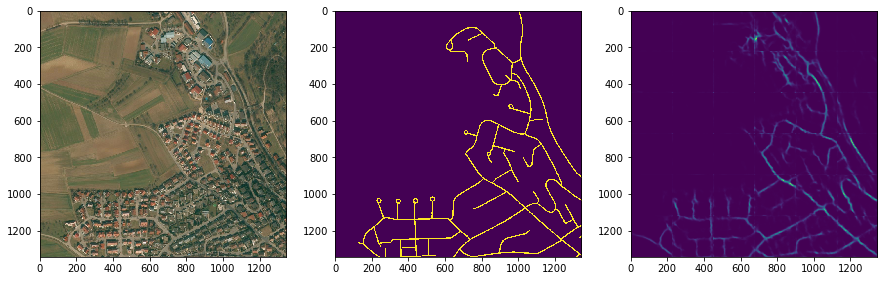

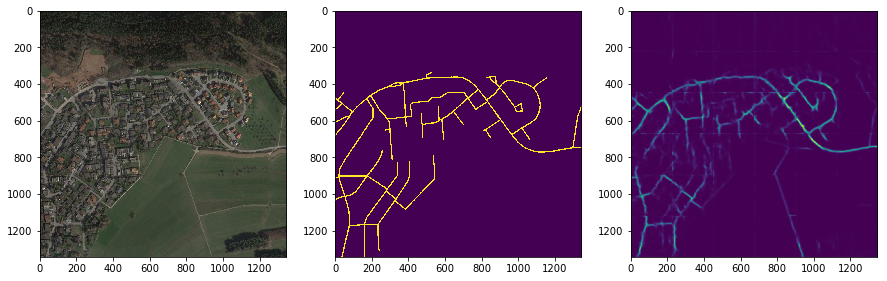

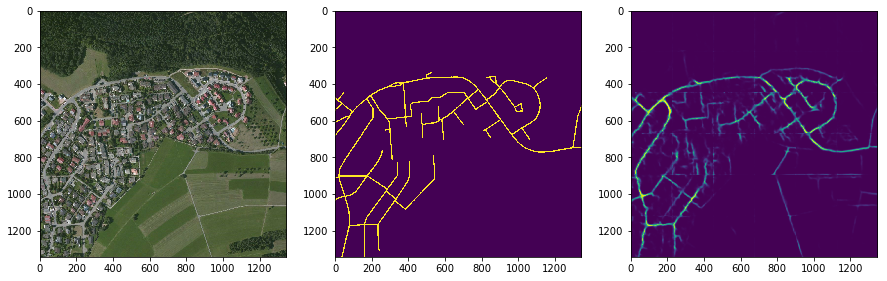

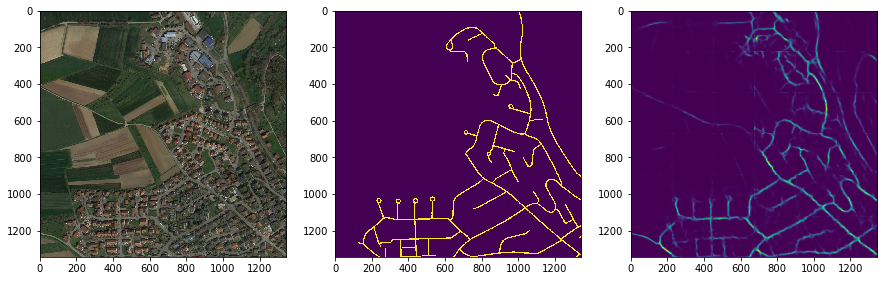

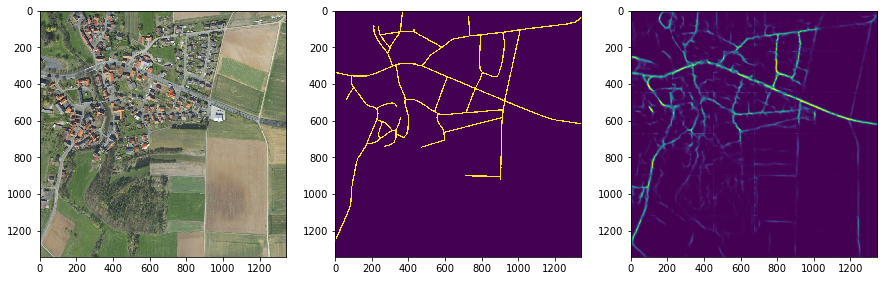

In [20]:
plot_slices_merged(plot_images,plot_masks,predictions)